In [1]:
%load_ext autoreload
%autoreload 2

# Comparisons - Guidance Scale


In [2]:
from src import helpers, interactive

PyTorch version: 2.0.1+cu117


GridBox(children=(Dropdown(description='model', index=2, layout=Layout(width='95%'), options=('stabilityai/sta…

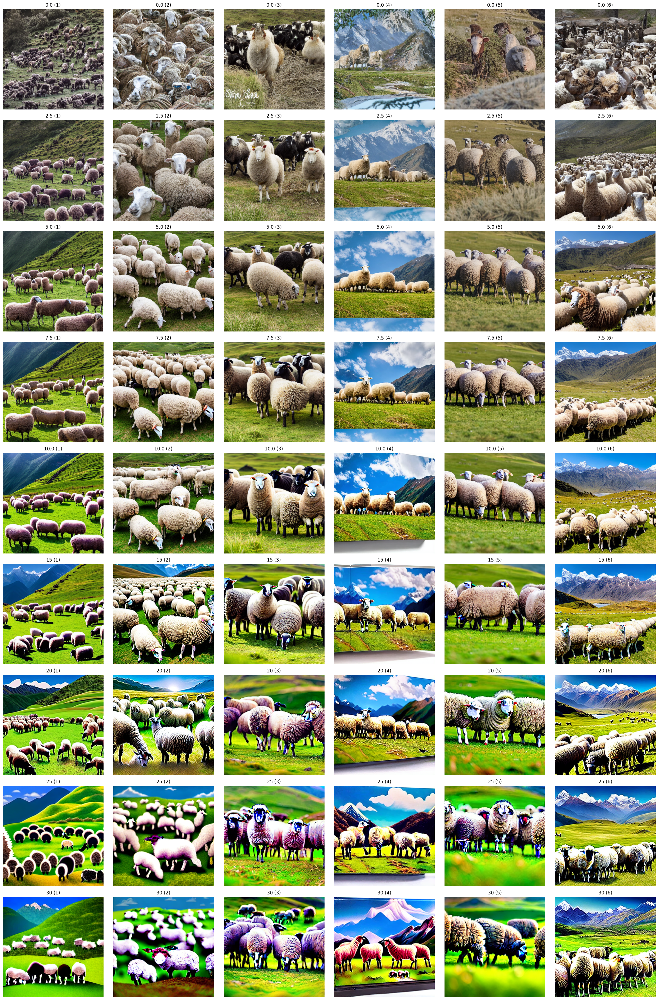

In [ ]:
icp = interactive.InteractivePipeline()
# We don't want to change the scheduler through the UI
icp.w_guidance_scale.layout.visibility = "hidden"
# We want the same seed for all runs
icp.w_seed.disabled = True
icp.w_seed.value = 123

guidance_scale_list = [0.0, 2.5, 5.0, 7.5, 10.0, 15, 20, 25, 30]


def run_btn_callback():
    # Function to run when the Run button is pressed
    imgs, captions = [], []

    for g in guidance_scale_list:
        imgs.extend(icp(guidance_scale=g))
        captions.extend([f"{g} ({i + 1})" for i in range(icp.num_images_per_prompt)])

    icp.show()
    helpers.plot(
        imgs,
        captions=captions,
        n_rows=len(guidance_scale_list),
        save_fname="plot_grid_guidance_scale",
    )


# We bind our callback function to the run button
icp.on_run = run_btn_callback
icp.show()